# Exploration 1.1: Generate spectrograms
Oscar Scholin

10/19/22

P-Ai Music

## Load packages

In [1]:
# defaults
import os, pydub
from os import path
import numpy as np

# audio specific
from pydub import AudioSegment
import matplotlib.pyplot as plt
from IPython.display import Audio

# machine learning
import tensorflow as tf
import tensorflow_io as tfio

2022-10-21 16:56:40.560081: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


## Prepare and load data

In [17]:
# assume we have already downloaded our mp3 files. we may need to convert into wav.
def convert_mp3_wav(path_name):
    for subpath in os.listdir(path_name):
        if ".mp3" in subpath:
            # assign files
            input_file = path.join(path_name, subpath)
            # create new subdirectory if does not already exist to store .wav files
            if not(path.isdir(path.join(path_name, 'output'))):
                os.mkdir(path.join(path_name, 'output'))
            output_file = path.join(path_name, 'output', subpath+'.wav')

            # convert mp3 file to wav file
            sound = AudioSegment.from_mp3(input_file)
            sound = sound.set_channels(1)
            sound.export(output_file, format="wav")

### Specific example -- can skip to pipeline below

In [2]:
DATA_PATH = '/Users/oscarscholin/Desktop/Pomona/Junior Year/P-ai/test_data/'

In [51]:
convert_mp3_wav(DATA_PATH)

In [3]:
# set path to file
TEST_FILE = path.join(DATA_PATH, 'output', 'Ketsa - Choice is Yours.mp3.wav')

In [6]:
TEST_FILE

'test_data/output/Ketsa - Choice is Yours.mp3.wav'

## New raw wav + spectrograms!

https://www.tensorflow.org/io/tutorials/audio

In [4]:
# create tensorflow tensor for song file
song_test = tfio.audio.AudioIOTensor(TEST_FILE)
song_test

2022-10-21 16:56:58.836903: I tensorflow_io/core/kernels/cpu_check.cc:128] Your CPU supports instructions that this TensorFlow IO binary was not compiled to use: AVX2 FMA
2022-10-21 16:56:58.973859: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


<AudioIOTensor: shape=[8038078       1], dtype=<dtype: 'int16'>, rate=44100>

In [5]:
# can play sample of clip -- slice and remove last dimension
song_slice = song_test[100:]
song_tensor = tf.squeeze(song_slice)
print(song_tensor)

tf.Tensor([ 0  0  0 ...  2 -1  1], shape=(8037978,), dtype=int16)


In [6]:
# listen to song
Audio(song_tensor.numpy(), rate=song_test.rate.numpy())

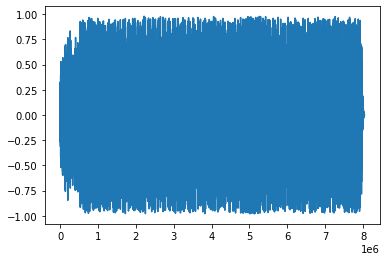

In [7]:
# visualize raw audio wave
tensor = tf.cast(song_tensor, tf.float32) / 32768.0
plt.figure()
plt.plot(tensor.numpy())

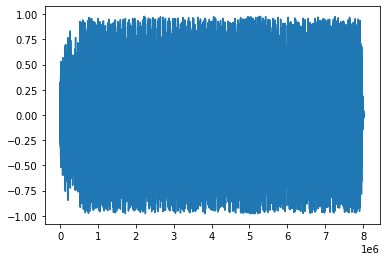

In [8]:
# fade in and out
fade = tfio.audio.fade(tensor, fade_in=1000, fade_out=2000, mode='logarithmic')
plt.figure()
plt.plot(fade.numpy())


In [25]:
os.chdir('./spectrograms-test/')

FileNotFoundError: [Errno 2] No such file or directory: './spectrograms-test/'

(-0.5, 5000.5, 2296.5, -0.5)

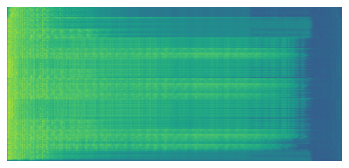

In [9]:
# convert to spectrogram
spectrogram = tfio.audio.spectrogram(
    fade, nfft=10000, window=4500, stride=3500
)
plt.imshow(tf.math.log(spectrogram).numpy())
plt.axis('off')
#plt.savefig('choice_is_yours_spec_10000_4000_2000.jpeg')

## Pipeline to generate spectrograms for all files

In [16]:
# set directory to store all spectrograms
os.chdir('/Users/oscarscholin/Desktop/Pomona/Junior Year/P-ai/spectrograms-test/all/')

In [10]:
# pass path to waveform and label to save figure
def generate_spectrogram(file_path, label, nfft, window, stride):
    
    # read in song as AudioIOTensor
    song_test = tfio.audio.AudioIOTensor(file_path)

    #read contents of file by slicing and removing last dimension
    song_slice = song_test[100:]
    song_tensor = tf.squeeze(song_slice)

    # visualize raw audio wave
    tensor = tf.cast(song_tensor, tf.float32) / 32768.0    

    # apply fade
    fade = tfio.audio.fade(tensor, fade_in=1000, fade_out=2000, mode='logarithmic')

    
    # convert to spectrogram
    # nnft: number of fast fourier transforms; 10,000 seems to work well
    # window: size of window?; if window is too small you will not be able to see it
    # stride: number of "hops" between windows?; not really sure what this means
    # defaults: nfft=10000, window=4000, stride=2000
    spectrogram = tfio.audio.spectrogram(
        fade, nfft=nfft, window=window, stride=stride
    )
    # comment this out for doing lots of files!!
    print(label)
    plt.figure(figsize=(10, 5))
    plt.imshow(tf.math.log(spectrogram).numpy())
    plt.savefig(label+'.jpeg')

In [11]:
def get_spectrograms(path_name,nfft=10000, window=4000, stride=2000):
    # convert all mp3 to mono-channel .wav
    convert_mp3_wav(path_name)

    #generate spectrograms for each ouput wav from above
    for i, subpath in enumerate(os.listdir(path_name+'/output/')):
        #print(subpath)
        if '.wav' in subpath:
            file_path = path.join(path_name+'/output/', subpath)
            # label is subpathup to first period
            label = subpath.split('.')[0]+'_spec_'+str(nfft)+'_'+str(window)+'_'+str(stride)
            generate_spectrogram(file_path, label, nfft, window, stride)

        percent = round((i/len(os.listdir(path_name+'/output/')))*100, 3)
        print ('progress: ' + str(percent) + '%', end="\r")

Ketsa - Choice is Yours_spec_10000_4000_2000
Ketsa - Frizz_spec_10000_4000_2000


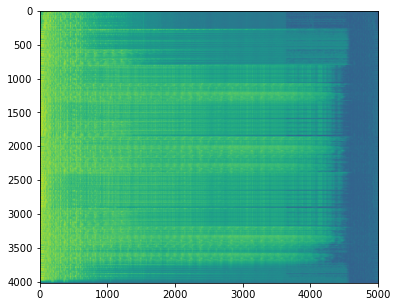

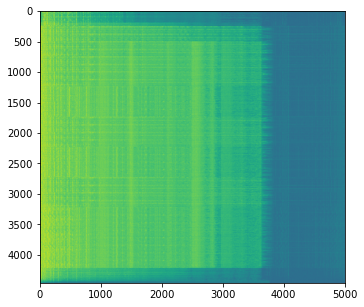

In [35]:
get_spectrograms(DATA_PATH)

In [42]:
DATA_PATH

'/Users/oscarscholin/Desktop/Pomona/Junior Year/P-ai/test_data/'

### Playing with parameters in spectrogram function

In [12]:
# change cwd
os.chdir('/Users/oscarscholin/Desktop/Pomona/Junior Year/P-ai/spectrograms-test/exploration/')

In [13]:
# use TEST_FILE on distinct combinations of nfft, window, stride
#nfft: 100 to 10,000
nfft_list = [1000*i for i in range(1, 10, 1)]
#window: 100 to 5000
window_list = [500*i for i in range(2, 10, 1)]
#stride: 500 to 4000
stride_list = [500*i for i in range(1, 8, 1)]

In [ ]:
for i in nfft_list:
    for j in window_list:
        for k in stride_list:
            label='ketsa_spec'+str(i)+'_'+str(j)+'_'+str(k)
            generate_spectrogram(TEST_FILE, label, i, j, k)